In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.path import Path
from scipy.spatial import Delaunay
from scipy.spatial.transform import Rotation as R
from itertools import groupby
import scipy.special
from collections import defaultdict
from tqdm import tqdm

%matplotlib inline
%config InlineBackend.figure_format='retina'
plt.rcParams['text.usetex'] = True
np.set_printoptions(suppress=True)

## Generating data

Too coarse of a sampling resolution will yield inaccuracies in the angle computations, so we are massively oversampling here. Most of the data will be downsampled later. Since the gamma function has mirror symmetry -- the function has the same output for any input value and its complex conjugate -- we only need to compute half the values. This also has the side effect of eliminating certain irregularities in the computation of the phase angle for input values along the real axis.

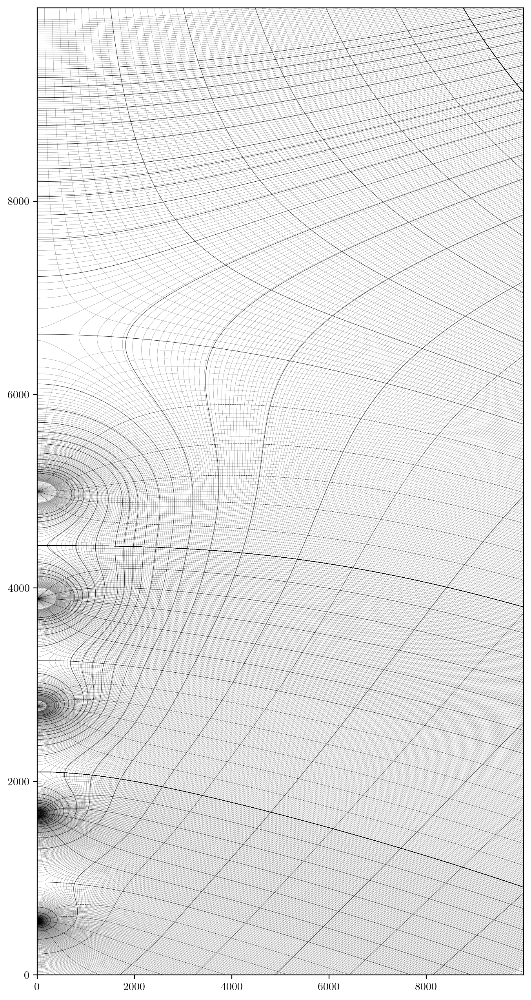

In [2]:
# Sample resolution
res = 10000

# Real sample interval
r_min, r_max = -4.5, 4.5

# Imaginary sample interval
# Values along real axis added later
i_min, i_max = 0.0001, 2.5

real = np.linspace(r_min, r_max, res)
imag = np.linspace(i_min, i_max, res)

# Create sample grid
grid = real[:, None] + 1j*imag

# Evaluate function across grid
gamma = scipy.special.gamma(grid)
plt.figure(figsize=(8,16))

# Calculate magnitude and phase angle values
magnitude = np.abs(gamma)
angle = np.angle(gamma)

min_log_value = -4
max_log_value = 1
log_base = 10
angle_major_division = 12
magnitude_major_division = 48
minor_division = 10

angle_major_interval = np.linspace(-np.pi, np.pi, 1 + angle_major_division)
angle_minor_interval = np.setdiff1d(np.linspace(-np.pi, np.pi, 1 + angle_major_division*minor_division), angle_major_interval)


magnitude_major_interval = np.array([.0003,0.001,.003,0.01,.03,0.1,0.2,0.4,0.6,0.8,1,1.2,1.4,1.6,1.8,2,2.5,3,3.5,4,4.5,5,5.5])
# Sample at logrithmic interval to obtain finer resolution for smaller magnitude values
magnitude_minor_interval = np.logspace(min_log_value, max_log_value, 1 + magnitude_major_division*minor_division, base=10)
# Eliminate redundant minor contours
magnitude_minor_interval = np.array(list(filter(lambda x: np.all(np.abs(magnitude_major_interval - x) > .000001),
                                                magnitude_minor_interval)))

magnitude_major_contours = plt.contour(magnitude, levels=magnitude_major_interval, colors='k', linewidths=.3)
magnitude_minor_contours = plt.contour(magnitude, levels=magnitude_minor_interval, colors='k', linewidths=.1)
angle_major_contours = plt.contour(angle, levels=angle_major_interval, colors='k', linewidths=.3)
angle_minor_contours = plt.contour(angle, levels=angle_minor_interval, colors='k', linewidths=.1)

plt.show()

## Extracting contour data and culling redundant contours

Since the phase angle of the output of the gamma function contains discontinuities, there are several contours that appear to nearly overlap. We can eliminate contours having a shared beginning and end point. Since matplotlib generates contour data relative to index values, the data needs to be rescaled back to its original shape.

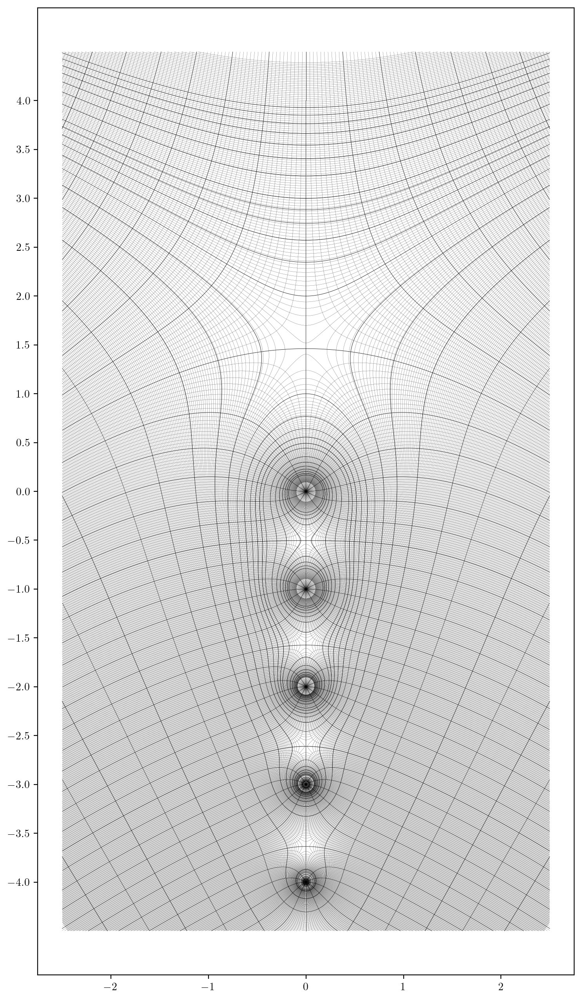

In [3]:
# Iterate through collection of matplotlib contours, return array of xyz data and corresponding index values

def extractContours(contours, res):
    points = []
    indices = []
    paths = [collection.get_paths() for collection in contours.collections]
    paths = [x for y in paths for x in y]

    for i, path in enumerate(paths):
        # Eliminate overlapping contours by comparing endpoints
        overlap = False
        for j in range(i-1):
            comp = paths[j]
            s1, s2 = path.vertices[0], comp.vertices[0]
            e1, e2 = path.vertices[-1], comp.vertices[-1]
            if np.allclose(s1, s2, atol=3) and np.allclose(e1, e2, atol=3):
                overlap = True
                break
        # Evaluate function at each point along contour, generate contour index values
        if not overlap:
            xy = path.vertices.copy()
            xy *= np.array([(i_max-i_min)/res, (r_max-r_min)/res])
            xy[:,1] -= (r_max-r_min)/2
            z = np.abs(scipy.special.gamma(xy[:,1] + xy[:,0]*1j))
            xyz = np.vstack((xy.T, np.reshape(z, -1))).T
            point_set = [p for p in xyz]
            points += point_set
            indices += [i for _ in range(len(point_set))]

    return np.array(points), np.array(indices)

# Plot contour set, grouping by index value
def plotContours(xyz, indices, w=.1):
    xyzi = np.hstack((xyz, indices.reshape(-1,1)))
    for _, g in groupby(xyzi, lambda x: x[-1]): 
        xy = np.array(list(g))[:,:2]
        plt.plot(*xy.T, lw=w, c='k')

angle_major_xyz, angle_major_indices = extractContours(angle_major_contours, res)
angle_minor_xyz, angle_minor_indices = extractContours(angle_minor_contours,res)
magnitude_major_xyz, magnitude_major_indices = extractContours(magnitude_major_contours, res)
magnitude_minor_xyz, magnitude_minor_indices = extractContours(magnitude_minor_contours, res)

# Fill in missing phase angle contour along real axis
centerline_xy = np.vstack((np.zeros((1, res)), np.linspace(r_min, r_max, res)))
centerline_z = np.abs(scipy.special.gamma(centerline_xy[1] + centerline_xy[0]*1j))
centerline_xyz = np.vstack((centerline_xy, np.reshape(centerline_z, -1))).T
# Split into contours with endpoints at poles of function
centerline_indices = np.ceil(centerline_xyz[:,1])

fine_threshold = 1.3
coarse_interval = 20

z_range = magnitude_major_interval[[-1,-4,-6,-7]][::-1]

# Cull majority of datapoints lying outside of critical zone to save memory
angle_major_modulus = np.mod(np.arange(angle_major_xyz.shape[0]), coarse_interval)
angle_major_condition = (angle_major_xyz[:,-1] > fine_threshold) | ~(angle_major_modulus > 0)
angle_major_xyz = angle_major_xyz[angle_major_condition]
angle_major_indices = angle_major_indices[angle_major_condition]

# Generate mirror image of data and stack with original data
angle_major_mirror = angle_major_xyz.copy()
angle_major_mirror[:,0] *= -1
angle_major_xyz = np.vstack((angle_major_xyz, 
                              angle_major_mirror,
                              centerline_xyz))
angle_major_indices = np.hstack((angle_major_indices, 
                                 angle_major_indices + np.max(angle_major_indices) + 1,
                                 centerline_indices))

angle_minor_modulus = np.mod(np.arange(angle_minor_xyz.shape[0]), coarse_interval)
angle_minor_condition = (angle_minor_xyz[:,-1] > fine_threshold) | ~(angle_minor_modulus > 0)
angle_minor_xyz = angle_minor_xyz[angle_minor_condition]
angle_minor_indices = angle_minor_indices[angle_minor_condition]

angle_minor_mirror = angle_minor_xyz.copy()
angle_minor_mirror[:,0] *= -1
angle_minor_xyz = np.vstack((angle_minor_xyz, angle_minor_mirror))
angle_minor_indices = np.hstack((angle_minor_indices,angle_minor_indices + np.max(angle_minor_indices) + 1))

magnitude_major_xyz, magnitude_major_indices = magnitude_major_xyz[::20], magnitude_major_indices[::20]
magnitude_major_mirror = magnitude_major_xyz.copy()
magnitude_major_mirror[:,0] *= -1
magnitude_major_xyz = np.vstack((magnitude_major_xyz, magnitude_major_mirror))
magnitude_major_indices = np.hstack((magnitude_major_indices, magnitude_major_indices + np.max(magnitude_major_indices) + 1))

magnitude_minor_xyz, magnitude_minor_indices = magnitude_minor_xyz[::20], magnitude_minor_indices[::20]
magnitude_minor_mirror = magnitude_minor_xyz.copy()
magnitude_minor_mirror[:,0] *= -1
magnitude_minor_xyz = np.vstack((magnitude_minor_xyz, magnitude_minor_mirror))
magnitude_minor_indices = np.hstack((magnitude_minor_indices,magnitude_minor_indices + np.max(magnitude_minor_indices) + 1))


plt.figure(figsize=(16,16))

plotContours(magnitude_major_xyz, magnitude_major_indices, w=.3)
plotContours(magnitude_minor_xyz, magnitude_minor_indices)
plotContours(angle_major_xyz, angle_major_indices, w=.3)
plotContours(angle_minor_xyz, angle_minor_indices)

plt.axis('scaled')
plt.yticks(np.linspace(-4, 4, 17))

#plt.axis('off')
plt.show()

## Generating line shading on tops of poles at zero and negative integer values

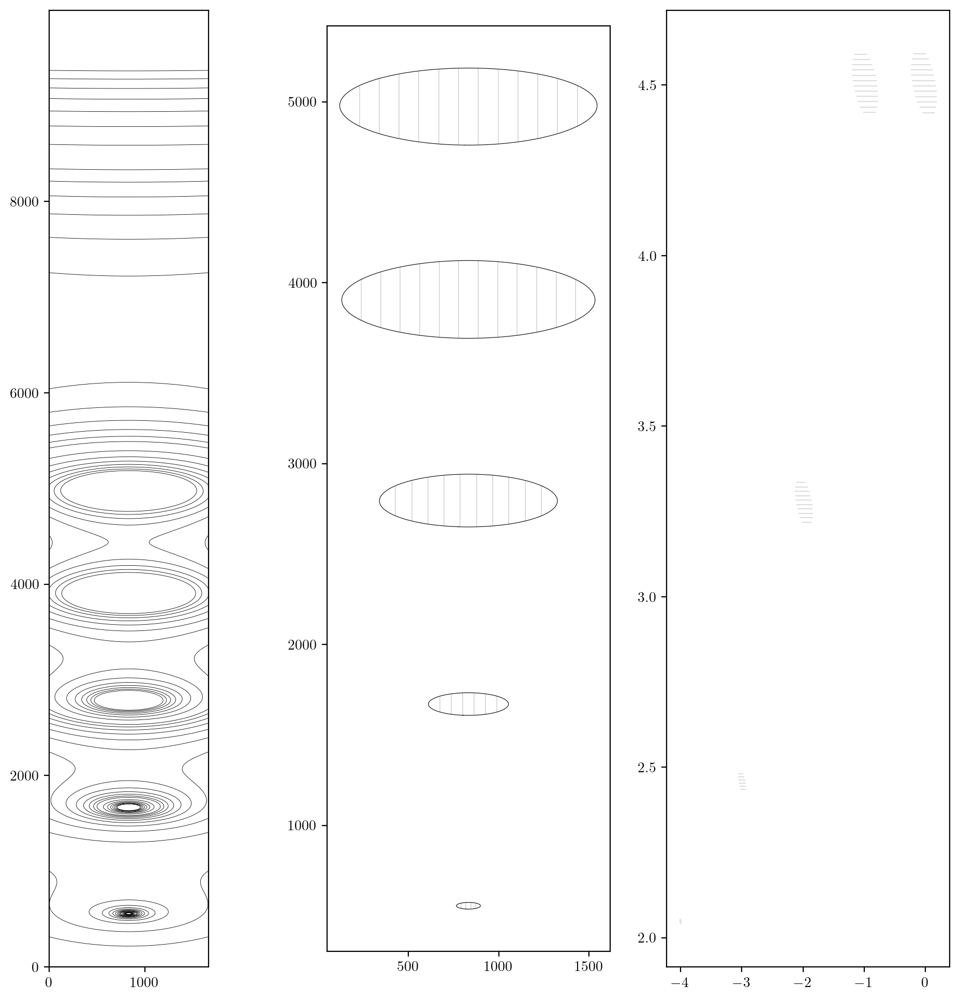

In [4]:
x_angle = -55
z_angle = -90
rx = R.from_euler('x', x_angle, degrees=True)
rz = R.from_euler('z', z_angle, degrees=True)
isometric_scale_factor = .5

res2 = res
top_contour_real_scale = 6
top_contour_imag_scale = 12
real2 = np.linspace(-r_max, r_max, res2)
imag2 = np.linspace(-i_max/top_contour_imag_scale, i_max/top_contour_imag_scale, res2//top_contour_real_scale)
grid2 = real2[:, None] + 1j*imag2
gamma2 = scipy.special.gamma(grid2)
magnitude2 = np.abs(gamma2)

fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=((12,12)))

magnitude_major_contours2 = ax1.contour(magnitude2, levels=magnitude_major_interval, colors='k', linewidths=.3)

ax1.axis('scaled')

contours_of_interest = []
cutoff_contours = [magnitude_major_contours2.collections[i] for i in reversed([-1,-4,-6,-7])]
for collection, limit in zip(cutoff_contours, [-3.5, -2.5, -1.5, .5]):
    paths = collection.get_paths()
    for path in paths:
        _, y = path.vertices.copy().T
        y *= (r_max-r_min)/res
        y -= (r_max-r_min)/2
        if ~(np.any(y > limit)) & np.any((y < limit) & (y > (limit-(1+(limit==.5))))):
            contours_of_interest.append(path)

cs = []
top_contour_indices = []
count = 0

for p in contours_of_interest:
    l, b = np.min(p.vertices, axis=0)
    r, t = np.max(p.vertices, axis=0)
    for x in np.linspace(l, r, 6+int((r-l)/160)):
        c = []
        for y in np.linspace(b, t, 400):
            xy = np.array([x, y])
            if p.contains_point(xy):
                c.append(xy)
        if len(c) >= 2:
            cs.append(np.array(c))
            top_contour_indices += [count for _ in c]
            count += 1

for path in contours_of_interest:
    ax2.plot(*path.vertices.T, lw=.4, c='k')

for c in cs:
    ax2.plot(*np.array(c).T, lw=.1, c='k')

ax2.axis('scaled')


top_contours = []
for c in cs:
    # select start and end points
    points = c[[0,-1]]
    # rescale points to match original data    
    points[:,0] -= res2/12
    points[:,1] -= res/2
    points[:,0] *= 2*(i_max/12-i_min/12)/(res/6)
    points[:,1] *= (r_max-r_min) / res
    z = np.abs(scipy.special.gamma(points[0,1]+1j*points[0,0]))
    z = np.full(2, z_range[np.argmin(np.abs(z_range - z))])
    xyz = np.vstack((points.T, z)).T
    xyz[:,1] += isometric_scale_factor*points[:,0]
    top_contours.append(rx.apply(rz.apply(xyz))[:,:2])

for c in top_contours:
    ax3.plot(*c.T, lw=.1, c='k')      

plt.show()

## Thresholding z-values and adding bounding box and line shading

(1687420, 3)


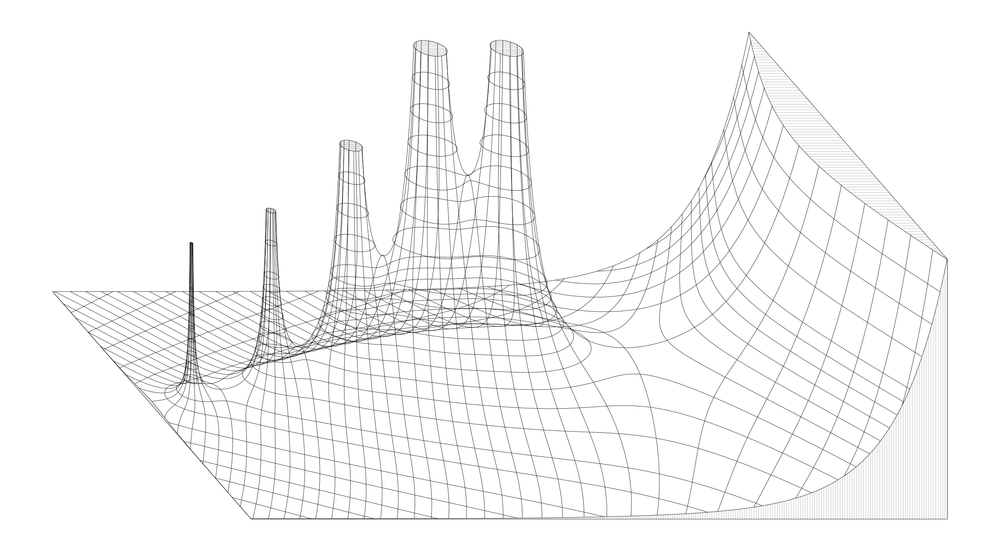

In [5]:
epsilon = .1

for y, z in zip([-3.5, -2.5, -1.5, .5], z_range):
    condition = ~((magnitude_major_xyz[:,1] < y) & (magnitude_major_xyz[:,2] > z + epsilon))
    magnitude_major_xyz = magnitude_major_xyz[condition]
    magnitude_major_indices = magnitude_major_indices[condition]

for y, z in zip([-3.5, -2.5, -1.5, .5], z_range):
    condition = ~((magnitude_minor_xyz[:,1] < y) & (magnitude_minor_xyz[:,2] > z + epsilon/10))
    magnitude_minor_xyz = magnitude_minor_xyz[condition]
    magnitude_minor_indices = magnitude_minor_indices[condition]

nan_condition = ~np.isnan(angle_major_xyz[:,2])
angle_major_xyz = angle_major_xyz[nan_condition]
angle_major_indices = angle_major_indices[nan_condition] 

# Truncate data at predetermined height intervals

epsilon_values = [.001, .01,.005,.01]

for y, z, eps in zip([-3.5, -2.5, -1.5, .5], z_range, epsilon_values):
    condition = ((angle_major_xyz[:,1] < y) & (angle_major_xyz[:,2] > z))
    angle_major_xyz[condition, 2] = z
    diff1 = np.insert(np.diff(angle_major_xyz[:,2]), 0, 0).astype(bool)
    diff2 = np.insert(np.diff(angle_major_xyz[:,2]), -1, 0).astype(bool)
    condition2 = (angle_major_xyz[:,1] > y) | ((diff1 | diff2) & (np.linalg.norm(angle_major_xyz[:,:2]-np.round(angle_major_xyz[:,:2]), axis=1)>eps))
    angle_major_xyz = angle_major_xyz[condition2]
    angle_major_indices = angle_major_indices[condition2]

for y, z, eps in zip([-3.5, -2.5, -1.5, .5], z_range, epsilon_values):
    condition = ((angle_minor_xyz[:,1] < y) & (angle_minor_xyz[:,2] > z))
    angle_minor_xyz[condition, 2] = z
    diff1 = np.insert(np.diff(angle_minor_xyz[:,2]), 0, 0).astype(bool)
    diff2 = np.insert(np.diff(angle_minor_xyz[:,2]), -1, 0).astype(bool)
    condition2 = (angle_minor_xyz[:,1] > y) | ((diff1 | diff2) & (np.abs(angle_minor_xyz[:,1] - np.round(angle_minor_xyz[:,1]))>eps))
    angle_minor_xyz = angle_minor_xyz[condition2]
    angle_minor_indices = angle_minor_indices[condition2]

z_limit = magnitude_major_interval[-4]
epsilon = .1

condition = (magnitude_major_xyz[:,1] < 0.5) | (magnitude_major_xyz[:,2] < z_limit + epsilon)
magnitude_major_xyz = magnitude_major_xyz[condition]
magnitude_major_indices = magnitude_major_indices[condition]
major_xyz_correction = np.array([np.argmin(np.abs(magnitude_major_interval - z)) for z in magnitude_major_xyz[:,2]])
magnitude_major_xyz[:,2] = magnitude_major_interval[major_xyz_correction]

condition = (magnitude_minor_xyz[:,1] < 0.5) | (magnitude_minor_xyz[:,2] < z_limit + epsilon/10)
magnitude_minor_xyz = magnitude_minor_xyz[condition]
magnitude_minor_indices = magnitude_minor_indices[condition]

condition = (angle_major_xyz[:,1] < 0.5) | (angle_major_xyz[:,2] < z_limit)
angle_major_xyz = angle_major_xyz[condition]
angle_major_indices = angle_major_indices[condition]

condition = (angle_minor_xyz[:,1] < 0.5) | (angle_minor_xyz[:,2] < z_limit)
angle_minor_xyz = angle_minor_xyz[condition]
angle_minor_indices = angle_minor_indices[condition]

# We have to treat the base seperately from the rest of the data
# since it yields degeneracies in the Delaunay triangulation.

real_sample_width = 300
imaginary_sample_width = int(i_max * real_sample_width / (r_max - r_min))

top_sample_interval = np.linspace(-i_max, i_max, imaginary_sample_width)
back_sample_interval =np.linspace(-i_max, i_max, 2*imaginary_sample_width) 
base_xy_minor = []
cutoff_point = r_max

for i in top_sample_interval[:-1]:
    r = cutoff_point
    z = np.abs(scipy.special.gamma(r + 1j*i))
    while z > z_limit:
        r -= .005
        z = np.abs(scipy.special.gamma(r + 1j*i))
    if cutoff_point == r_max:
        cutoff_point = r+.005
    else:
        points = np.array([[i, cutoff_point, z_limit],
                           [i, r+.005, z_limit]])
        points[:,1] += isometric_scale_factor*points[:,0]
        base_xy_minor.append(rx.apply(rz.apply(points))[:,:2])

back_threshold = 0.005

for i in back_sample_interval[:-1]:
    z = np.abs(scipy.special.gamma(r_min + 1j*i))
    if z >= back_threshold:
        points = np.array([[i, r_min, 0],
                           [i, r_min, z]])
        points[:,1] += isometric_scale_factor*points[:,0]
        base_xy_minor.append(rx.apply(rz.apply(points))[:,:2])

base_xyz_major = np.array([[i_max, r_min, np.abs(scipy.special.gamma(r_min+1j*i_max))],
                           [i_max, cutoff_point, np.abs(scipy.special.gamma(r_min+1j*i_max))],
                           [i_max, cutoff_point, z_limit]])

base_xyz_major[:,1] += isometric_scale_factor*base_xyz_major[:,0]

base_xy_major = rx.apply(rz.apply(base_xyz_major))[:,:2]

base_min_distance = .01
base_sample_interval = np.linspace(r_min, cutoff_point, real_sample_width)

for r in base_sample_interval:
    points = np.array([[i_max, r, np.abs(scipy.special.gamma(r_min+1j*i_max))],
                       [i_max, r, np.minimum(z_limit, np.abs(scipy.special.gamma(r+1j*i_max)))]])
    if points[1,2] - points[0,2] > base_min_distance:
        points[:,1] += isometric_scale_factor*points[:,0]
        base_xy_minor.append(rx.apply(rz.apply(points))[:,:2])


i_interval = 2*(imag-np.mean(imag))
r_interval = np.linspace(r_min, cutoff_point, res)
bounds_intervals = [r_min+1j*i_interval,
                    r_min+1j*i_interval, 
                    cutoff_point+1j*i_interval, 
                    r_interval+1j*(-i_max), 
                    r_interval+1j*i_max]
bounds_indices = np.array([np.full(x.shape[0], i) for x, i in zip(bounds_intervals, range(len(bounds_intervals)))]).flatten()
bounds = np.array([np.clip(np.abs(scipy.special.gamma(x)), 0, z_limit) for x in bounds_intervals])
bounds[0] = 0
bounds_xyz = [np.vstack((np.imag(c), np.real(c), z)) for c, z in zip(bounds_intervals, bounds)]
bounds_xyz = np.hstack(bounds_xyz).T

major_xyz = np.vstack((magnitude_major_xyz,
                       angle_major_xyz,
                       bounds_xyz))


major_indices = np.hstack((magnitude_major_indices,
                           angle_major_indices,
                           bounds_indices))

minor_xyz = np.vstack((magnitude_minor_xyz,
                        angle_minor_xyz))

minor_indices = np.hstack((magnitude_minor_indices,
                           angle_minor_indices))

all_xyz = np.vstack((major_xyz, minor_xyz))

major_xyz[:,1] += isometric_scale_factor*major_xyz[:,0]
major_rotated = rx.apply(rz.apply(major_xyz))

minor_xyz[:,1] += isometric_scale_factor*minor_xyz[:,0]
minor_rotated = rx.apply(rz.apply(minor_xyz))

all_rotated = np.vstack((major_rotated, minor_rotated))
print(all_rotated.shape)

plt.figure(figsize=(16,16))
plotContours(major_rotated, major_indices,w=.3)
#plotContours(minor_rotated, minor_indices,w=.1)
plt.plot(*base_xy_major.T, lw=.3, c='k')
for c in base_xy_minor:
    plt.plot(*c.T, lw=.1, c='k')
for c in top_contours:
    plt.plot(*c.T, lw=.1, c='k')
plt.axis('scaled')
plt.axis('off')
plt.savefig('gamma_raw.svg')
plt.show()

## Delaunay Triangulation

A simplicial covering of the original untransformed data is found using a Delaunay triangulation algorithm. This acts as a mesh that can be used to compute depth buffer values.

(1687420, 2)


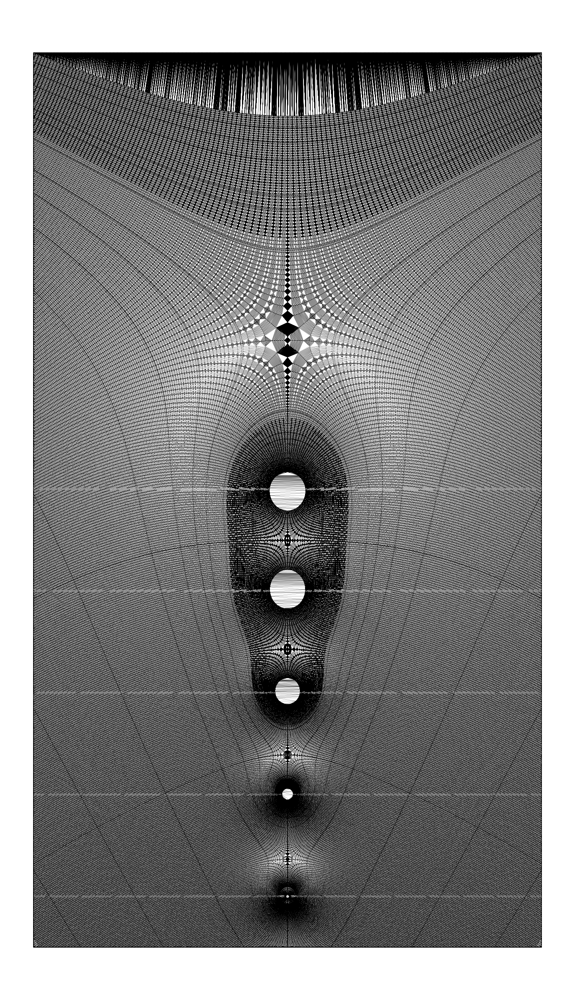

In [6]:
xy = np.array(all_xyz)[:,:2]
print(xy.shape)
tri_cone = Delaunay(xy)

plt.figure(figsize=(16,16))
plt.triplot(*xy.T, tri_cone.simplices, lw=.1, c='k')
plt.axis('scaled')
plt.axis('off')
plt.savefig('gamma_delaunay.png')
plt.show()

## Computing depth buffer values

The Z-buffer is a depth buffer that records the nearest z-value for each point in the projection plane. Methods are given for converting both directions between coordinate space and buffer index values.

In [7]:
class Z_Buffer:
    def __init__(self, left, right, bottom, top, buffer_width, buffer_height):   
        self.buffer = np.full((buffer_height, buffer_width), -np.inf)
        self.image_size = np.array([top-bottom, right-left])
        self.lower = np.array([bottom, left])
        self.buffer_size = np.array([buffer_height, buffer_width])

    # Convert from coordinates to buffer indices
    def coord_to_index(self, coord):
        return np.floor(.01 + (self.buffer_size-1) * (coord - self.lower) / self.image_size)

    # Convert from buffer indices to coordinates
    def index_to_coord(self, index):
        return (index / (self.buffer_size - 1)) * self.image_size + self.lower

The transformed data is iterated over and the depth buffer is updated.

100%|███████████████████████████████| 3314731/3314731 [12:32<00:00, 4406.42it/s]


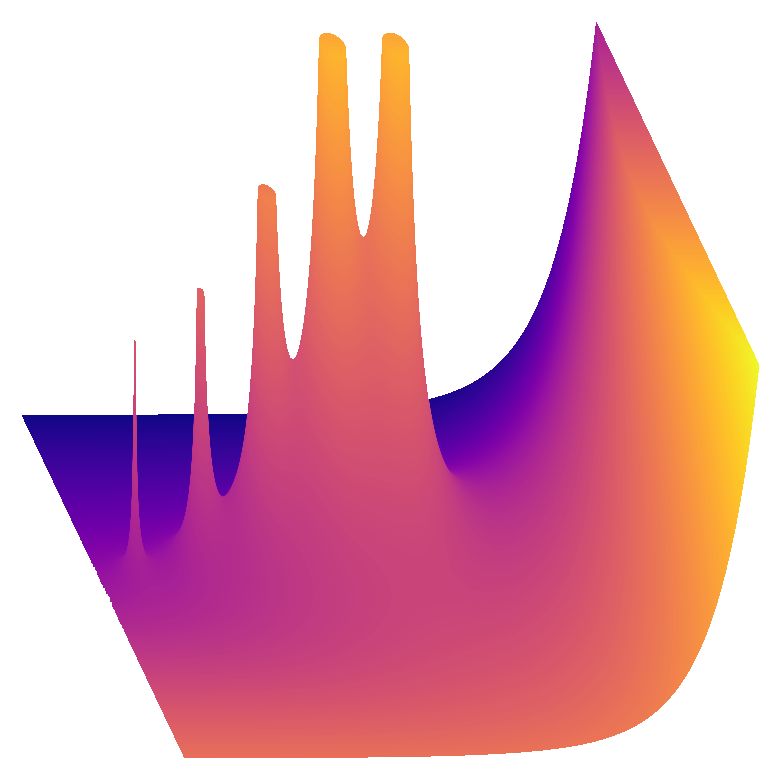

In [8]:
x_values, y_values, z_values = all_rotated.T

zb3 = Z_Buffer(np.min(y_values), np.max(y_values), np.min(x_values), np.max(x_values), 20000, 20000)

for i, t in enumerate(tqdm(tri_cone.simplices)):
    bottom, left = zb3.coord_to_index(np.array([np.min(x_values[t]), np.min(y_values[t])]))
    top, right = zb3.coord_to_index(np.array([np.max(x_values[t]), np.max(y_values[t])]))
    x_ind, y_ind = np.meshgrid(np.arange(bottom, top+1), np.arange(left, right+1))
    xy = zb3.index_to_coord(np.array((x_ind.flatten(), y_ind.flatten())).T)

    points = np.array([x_values[t], y_values[t]]).T
    
    # Find triangulation of points in projection plane
    single = Delaunay(points)

    b = single.transform[0,:2].dot(np.transpose(xy - single.transform[0,2]))
    weights = np.c_[np.transpose(b), 1 - b.sum(axis=0)]

    # Find ordering of points in triangle relative to original order
    tri_points = single.points[single.simplices[0]]

    u = np.argwhere(np.all(np.equal(points[0], tri_points), axis=1))
    v = np.argwhere(np.all(np.equal(points[1], tri_points), axis=1))
    w = np.argwhere(np.all(np.equal(points[2], tri_points), axis=1))

    weights = weights[:,np.array([u, v, w]).flatten()]
    bary_zs = np.dot(weights, z_values[t])
    x_filtered, y_filtered = xy[np.all(weights>0, axis=1)].T
    # Filter points that lie within simplex
    z_filtered = bary_zs[np.all(weights>0, axis=1)].T
    xi, yi = zb3.coord_to_index(np.array([x_filtered, y_filtered]).T).T.astype(np.int64)
    # Overwrite buffer value
    zb3.buffer[xi, yi] = np.maximum(z_filtered, zb3.buffer[xi, yi])

plt.imshow(zb3.buffer.T, origin='lower', cmap='plasma')
plt.axis('scaled')
plt.axis('off')
plt.savefig('gamma_zbuffer.png')
plt.show()

## Extracting outlines

The next step is to draw outlines around the figure in areas not enclosed by the bounding box. This can be done by thresholding the depth buffer and extracting the outline as a contour, then culling unnecessary points along the contour.

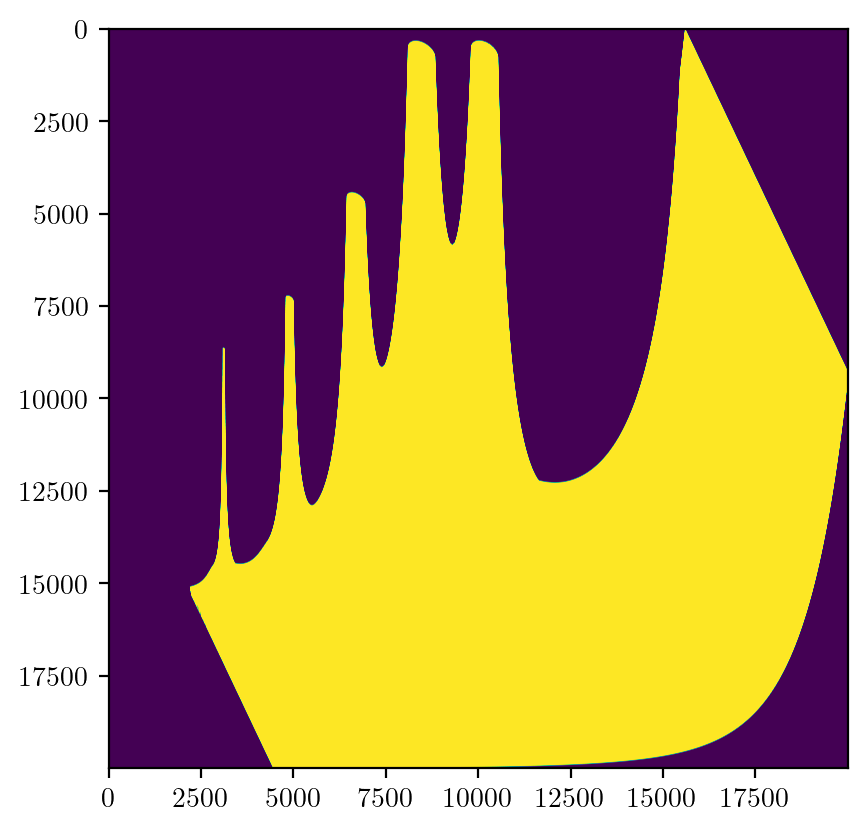

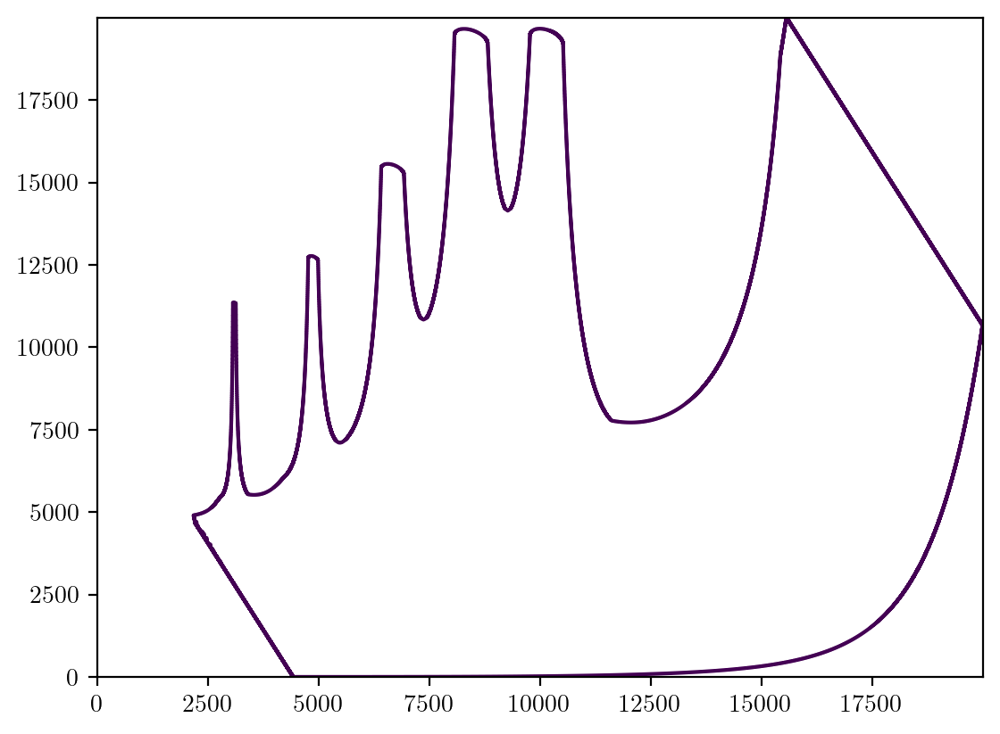

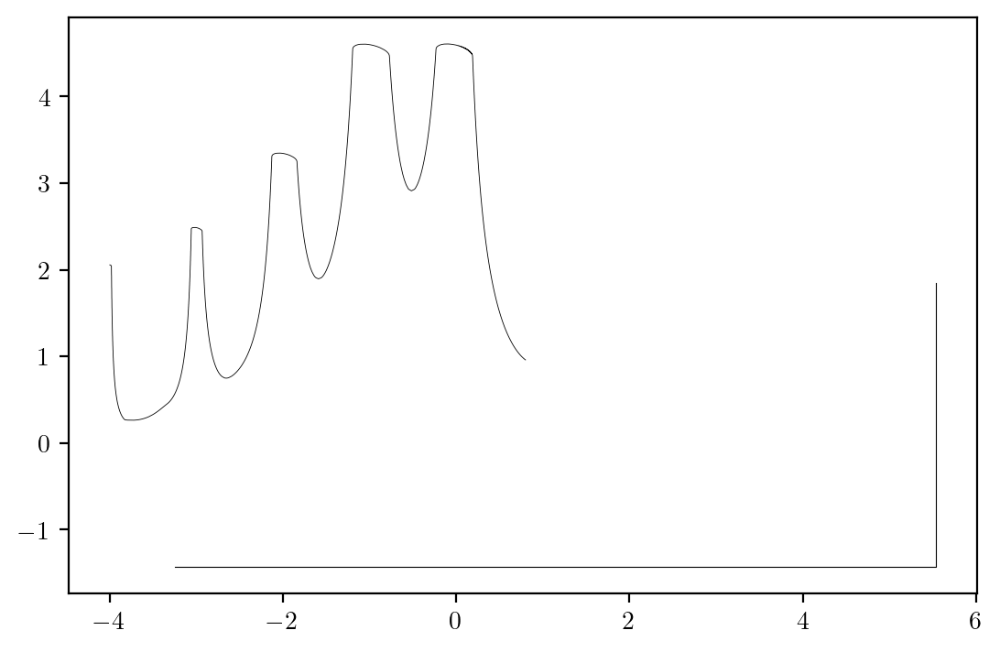

In [9]:
zbc = zb3.buffer.T.copy()
minval = np.min(zbc[~np.isinf(zbc)])
zbc[np.isnan(zbc)] = -1
zbc[np.isinf(zbc)] = -1
zbc[zbc>0] = 1
zbc[zbc<0] = -1

plt.imshow((zbc)[::-1])
plt.axis('scaled')
plt.show()

def extract_outline(contours, z_buffer):
    # There should only be one collection and one path
    path = contours.collections[0].get_paths()[0]
    # Convert contour representation beack to coordinate space
    return z_buffer.index_to_coord(path.vertices)

outline_points = extract_outline(plt.contour(zbc, [0]), zb3)
plt.show()

outline_min_cutoff = np.array([-4, 0])
outline_max_cutoff = np.array([.8, 5])
condition = np.all(outline_points > outline_min_cutoff, axis=1) & np.all(outline_points < outline_max_cutoff, axis=1)
outline_points = outline_points[condition]

plt.plot(*outline_points.T, c='k', lw=.3)
plt.plot(*base_xy_major.T, lw=.4, c='k')

plt.axis('scaled')
plt.show()

## Final Plot

Contour values are compared against the depth buffer and plotted if they lie within a marginal depth of the buffer value. Bounding boxes, line shading, and outline points are plotted seperately. The figure is saved as an SVG file.

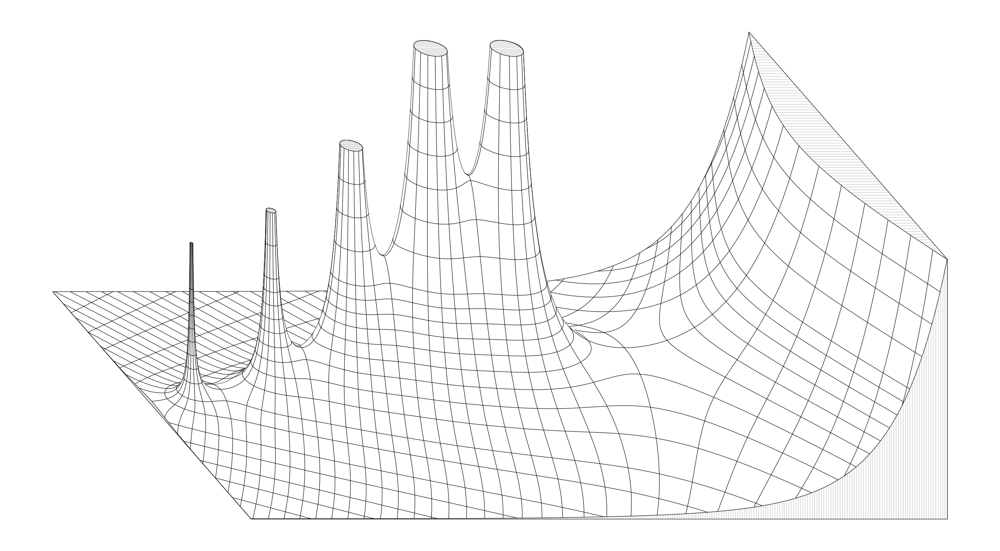

In [10]:
plt.figure(figsize=(16,16))

for _, g in groupby(np.hstack((major_rotated, major_xyz, major_indices.reshape(-1,1))), lambda x: x[-1]): 
    
    x, y, z, x2, y2, z2 = np.array(list(g)).T[:-1]
    vertex_sets = []
    current_set = []
    margin = .01
    for i in range(len(x)):
        xy_coords = zb3.coord_to_index(np.array([x[i], y[i]])).astype(np.int64)
        zed = zb3.buffer[xy_coords[0], xy_coords[1]]
        xyz2 = np.array([x2[i], y2[i], z2[i]])
        if z[i] + margin > zed:
            current_set.append(np.array([x[i], y[i]]))
        else:
            if len(current_set) < 2:
                current_set = []
            else:
                vertex_sets.append(np.array(current_set))
                current_set = []
    if current_set:
        vertex_sets.append(np.array(current_set))

    for xy in vertex_sets:
        plt.plot(*xy.T, lw=.4, c='k')

plt.plot(*base_xy_major.T, lw=.4, c='k')

plt.plot(*outline_points.T, c='k', lw=.3)

for c in base_xy_minor:
    plt.plot(*c.T, lw=.1, c='k')
for c in top_contours:
    plt.plot(*c.T, lw=.1, c='k')

plt.axis('scaled')
plt.axis('off')
plt.savefig('gamma_hi_res.svg')
plt.show()